In [ ]:
! pip install transformers nltk

In [ ]:
! pip install langdetect

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.5/981.5 kB 12.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for langdetect: filename=langdetect-1.0.9-py3-none-any.whl size=993222 sha256=5fc1d5413660ccc48148ee9ff93d476e3f1d1cf64a01e44eccb54edab8217703
  Stored in directory: /root/.cache/pip/wheels/95/03/7d/59ea870c70ce4e5a370638b5462a7711ab78fba2f655d05106
Successfully built langdetect


In [ ]:
! pip install spacy

In [ ]:
! python -m spacy download en_core_web_sm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.8/12.8 MB 35.5 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import string
from nltk.corpus import stopwords
import nltk
import spacy
import re

In [ ]:
from google.colab import drive

drive.mount('/content/drive')

file_paths = ['/content/drive/My Drive/healthpulse_reviews.csv',
              '/content/drive/My Drive/healthpulse_services.csv',
              '/content/drive/My Drive/healthpulse_summary.csv',
              ]

reviews_df = pd.read_csv(file_paths[0])
reviews_df.head()

Mounted at /content/drive


,review_id,service_id,review_text,position
0,47585,243,I went for a Chiropractic Adjustment and the e...,negative_claim
1,34398,955,I went for a Flu Shot and the experience was f...,negative_claim
2,40368,442,I went for a Dental Cleaning and the experienc...,rebuttal
3,93494,930,I went for a Flu Shot and the experience was d...,evidence
4,73000,535,I went for a General Checkup and the experienc...,evidence


In [ ]:
print("\nHealthpulse Reviews Bilgileri:")
reviews_df.info()


Healthpulse Reviews Bilgileri:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   review_id    5000 non-null   int64 
 1   service_id   5000 non-null   int64 
 2   review_text  5000 non-null   object
 3   position     5000 non-null   object
dtypes: int64(2), object(2)
memory usage: 156.4+ KB


In [ ]:
print("\nHealthpulse Reviews Verisi Eksik Değer Sayısı:")
reviews_df.isnull().sum()


Healthpulse Reviews Verisi Eksik Değer Sayısı:


,0
review_id,0
service_id,0
review_text,0
position,0


In [ ]:
services_df = pd.read_csv(file_paths[1])
services_df.head()

,service_id,service_name,description
0,968,X-ray Imaging,Reveal sister test role imagine remember new h...
1,243,General Checkup,Total let central here west company call work ...
2,955,Blood Test,Owner happy particularly think stay movie.
3,765,Vaccination,Discussion knowledge here assume treatment by.
4,170,Physical Therapy,Send cost capital administration leg pull let ...


In [ ]:
print("\nHealthpulse Services Bilgileri:")
services_df.info()


Healthpulse Services Bilgileri:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   service_id    10 non-null     int64 
 1   service_name  10 non-null     object
 2   description   10 non-null     object
dtypes: int64(1), object(2)
memory usage: 368.0+ bytes


In [ ]:
print("\nHealthpulse Services Verisi Eksik Değer Sayısı:")
services_df.isnull().sum()


Healthpulse Services Verisi Eksik Değer Sayısı:


,0
service_id,0
service_name,0
description,0


In [ ]:
summary_df = pd.read_csv(file_paths[2])
summary_df.head()

,service_id,summary_text
0,968,General feedback suggests that X-ray Imaging i...
1,243,General feedback suggests that General Checkup...
2,955,General feedback suggests that Blood Test is e...
3,765,General feedback suggests that Vaccination is ...
4,170,General feedback suggests that Physical Therap...


In [ ]:
print("\nHealthpulse Summary Bilgileri:")
summary_df.info()


Healthpulse Summary Bilgileri:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 2 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   service_id    10 non-null     int64 
 1   summary_text  10 non-null     object
dtypes: int64(1), object(1)
memory usage: 288.0+ bytes


In [ ]:
print("\nHealthpulse Summary Verisi Eksik Değer Sayısı:")
summary_df.isnull().sum()


Healthpulse Summary Verisi Eksik Değer Sayısı:


,0
service_id,0
summary_text,0


## info
- Eksik veri (missing data) yok.
- Veri tiplerinde bir sorun yok; tüm sütunlar uygun formatta görünüyor.

# Data Preprocessing

In [ ]:
# from langdetect import detect
# from collections import Counter

# def detect_language(text):
#     try:
#         return detect(text)
#     except:
#         return "unknown"

# services_df['language'] = services_df['description'].apply(detect_language)
# reviews_df['language'] = reviews_df['review_text'].apply(detect_language)
# summary_df['language'] = summary_df['summary_text'].apply(detect_language)

# services_lang_dist = Counter(services_df['language'])
# reviews_lang_dist = Counter(reviews_df['language'])
# summary_lang_dist = Counter(summary_df['language'])

# print("Services Language Distribution:", services_lang_dist)
# print("Reviews Language Distribution:", reviews_lang_dist)
# print("Summary Language Distribution:", summary_lang_dist)

In [ ]:
nltk.download('stopwords')
english_stopwords = set(stopwords.words('english'))

nlp = spacy.load("en_core_web_sm")

def clean_and_lemmatize_text(text, stopwords_list):
    text = text.lower()
    text = text.translate(str.maketrans("", "", string.punctuation))
    text = re.sub(r'\d+', '', text)
    text = re.sub(r'\s+', ' ', text).strip()
    doc = nlp(text)
    lemmatized_text = " ".join(
        token.lemma_ for token in doc if token.text not in stopwords_list and not token.is_punct
    )

    return lemmatized_text

services_df['description_cleaned'] = services_df['description'].apply(lambda x: clean_and_lemmatize_text(x, english_stopwords))
summary_df['summary_text_cleaned'] = summary_df['summary_text'].apply(lambda x: clean_and_lemmatize_text(x, english_stopwords))


services_sample = services_df.head(10)
services_sample

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


,service_id,service_name,description,description_cleaned
0,968,X-ray Imaging,Reveal sister test role imagine remember new h...,reveal sister test role imagine remember new hard
1,243,General Checkup,Total let central here west company call work ...,total let central west company call work word ...
2,955,Blood Test,Owner happy particularly think stay movie.,owner happy particularly think stay movie
3,765,Vaccination,Discussion knowledge here assume treatment by.,discussion knowledge assume treatment
4,170,Physical Therapy,Send cost capital administration leg pull let ...,send cost capital administration leg pull let ...
5,935,MRI Scan,Boy community accept idea get nature week four...,boy community accept idea get nature week four...
6,442,Flu Shot,At effort different affect piece chance purpos...,effort different affect piece chance purpose c...
7,535,Dental Cleaning,Fast hit role situation television never situa...,fast hit role situation television never situa...
8,930,Mental Health Counseling,Away carry item author southern green focus pl...,away carry item author southern green focus pl...
9,672,Chiropractic Adjustment,Director bed debate economic decade treatment ...,director bed debate economic decade treatment ...


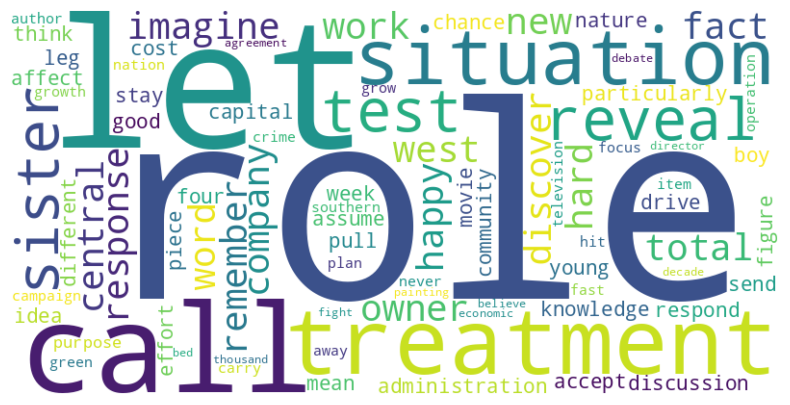

In [ ]:
from wordcloud import WordCloud

all_words = " ".join(services_df['description_cleaned']).split()
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(" ".join(all_words))
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

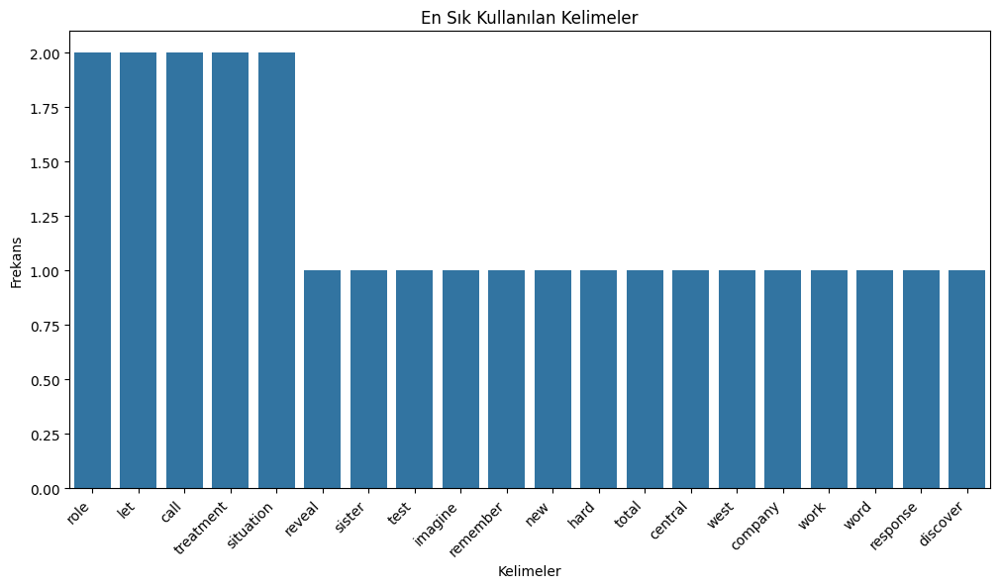

In [ ]:
from collections import Counter

all_words = " ".join(services_df['description_cleaned']).split()
word_freq = Counter(all_words)
top_words = word_freq.most_common(20)

words, freqs = zip(*top_words)

plt.figure(figsize=(12, 6))
sns.barplot(x=list(words), y=list(freqs))
plt.title('En Sık Kullanılan Kelimeler')
plt.xlabel('Kelimeler')
plt.ylabel('Frekans')
plt.xticks(rotation=45, ha='right')
plt.show()

In [ ]:
summary_sample = summary_df.head(10)
summary_sample

,service_id,summary_text,summary_text_cleaned
0,968,General feedback suggests that X-ray Imaging i...,general feedback suggest xray imaging effective
1,243,General feedback suggests that General Checkup...,general feedback suggest general checkup effec...
2,955,General feedback suggests that Blood Test is e...,general feedback suggest blood test effective
3,765,General feedback suggests that Vaccination is ...,general feedback suggest vaccination effective
4,170,General feedback suggests that Physical Therap...,general feedback suggest physical therapy cont...
5,935,General feedback suggests that MRI Scan is con...,general feedback suggest mri scan controversial
6,442,General feedback suggests that Flu Shot is eff...,general feedback suggest flu shot effective
7,535,General feedback suggests that Dental Cleaning...,general feedback suggest dental cleaning contr...
8,930,General feedback suggests that Mental Health C...,general feedback suggest mental health counsel...
9,672,General feedback suggests that Chiropractic Ad...,general feedback suggest chiropractic adjustme...


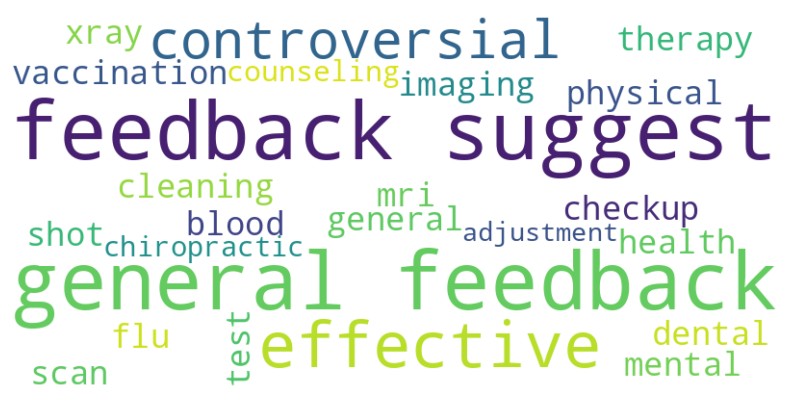

In [ ]:
from wordcloud import WordCloud

all_words = " ".join(summary_df['summary_text_cleaned']).split()
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(" ".join(all_words))
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

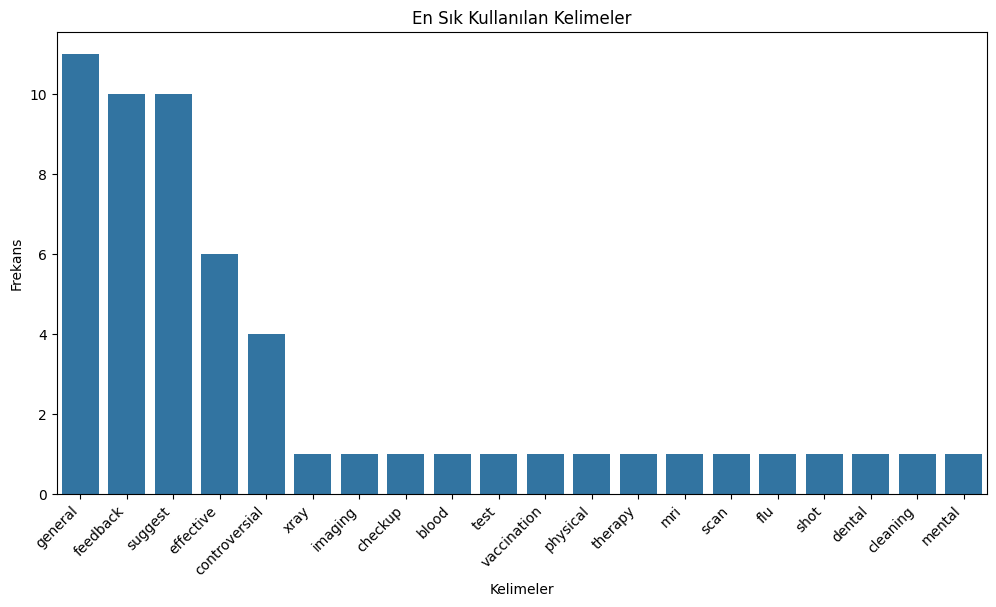

In [ ]:
all_words = " ".join(summary_df['summary_text_cleaned']).split()
word_freq = Counter(all_words)
top_words = word_freq.most_common(20)

words, freqs = zip(*top_words)

plt.figure(figsize=(12, 6))
sns.barplot(x=list(words), y=list(freqs))
plt.title('En Sık Kullanılan Kelimeler')
plt.xlabel('Kelimeler')
plt.ylabel('Frekans')
plt.xticks(rotation=45, ha='right')
plt.show()

In [ ]:
from nltk.corpus import stopwords
from collections import Counter
import nltk

nltk.download('stopwords')
nltk.download('punkt')

stop_words = set(stopwords.words('english'))

all_stopwords = []
for review in reviews_df['review_text']:
    tokens = nltk.word_tokenize(review.lower())
    stopwords_in_review = [token for token in tokens if token in stop_words]
    all_stopwords.extend(stopwords_in_review)

stopword_freq = Counter(all_stopwords)
stopword_freq.most_common(20)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


[('the', 20000),
 ('and', 15000),
 ('i', 10000),
 ('was', 10000),
 ('were', 10000),
 ('for', 5000),
 ('a', 5000),
 ('this', 5000),
 ('to', 5000),
 ('in', 2530),
 ('no', 2530),
 ('not', 2485),
 ('very', 2470)]

In [ ]:
import nltk
import spacy
import re
import string

nltk.download('stopwords')
english_stopwords = set(stopwords.words('english'))
custom_stopwords = english_stopwords - {"not", "no", "very"}

nlp = spacy.load("en_core_web_sm")

def clean_and_lemmatize_text(text, stopwords_list):
    text = text.replace("I went ", "")
    text = text.lower()
    text = text.translate(str.maketrans("", "", string.punctuation))
    text = re.sub(r'\d+', '', text)
    text = re.sub(r'\s+', ' ', text).strip()
    doc = nlp(text)
    lemmatized_text = " ".join(
        token.lemma_ for token in doc if token.text not in stopwords_list and not token.is_punct
    )

    return lemmatized_text

reviews_df['review_text_cleaned'] = reviews_df['review_text'].apply(lambda x: clean_and_lemmatize_text(x, custom_stopwords))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
reviews_sample = reviews_df.head(15)
reviews_sample

,review_id,service_id,review_text,position,review_text_cleaned
0,47585,243,I went for a Chiropractic Adjustment and the e...,negative_claim,chiropractic adjustment experience disappoint ...
1,34398,955,I went for a Flu Shot and the experience was f...,negative_claim,flu shot experience fantastic staff quite unpr...
2,40368,442,I went for a Dental Cleaning and the experienc...,rebuttal,dental cleaning experience disappoint staff qu...
3,93494,930,I went for a Flu Shot and the experience was d...,evidence,flu shot experience disappoint staff extremely...
4,73000,535,I went for a General Checkup and the experienc...,evidence,general checkup experience disappoint staff ex...
5,81786,672,I went for a Blood Test and the experience was...,negative_claim,blood test experience fantastic staff quite un...
6,39065,672,I went for a MRI Scan and the experience was d...,evidence,mri scan experience disappoint staff extremely...
7,16871,535,I went for a MRI Scan and the experience was d...,negative_claim,mri scan experience disappoint staff quite unp...
8,82783,955,I went for a Flu Shot and the experience was f...,evidence,flu shot experience fantastic staff quite unpr...
9,39733,170,I went for a Chiropractic Adjustment and the e...,evidence,chiropractic adjustment experience fantastic s...


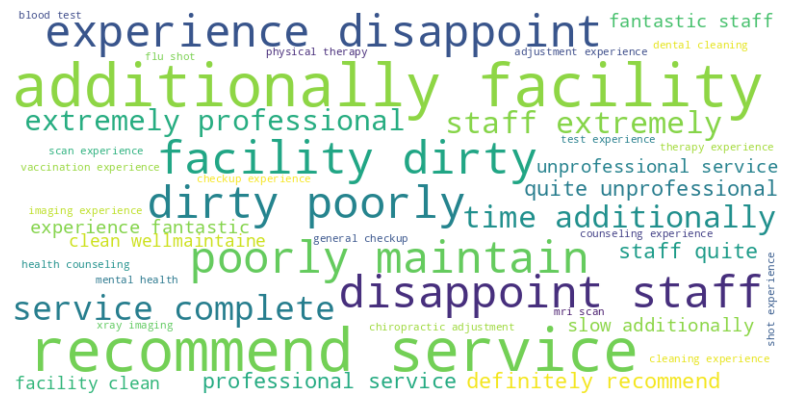

In [ ]:
from wordcloud import WordCloud

all_words = " ".join(reviews_df['review_text_cleaned']).split()
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(" ".join(all_words))
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

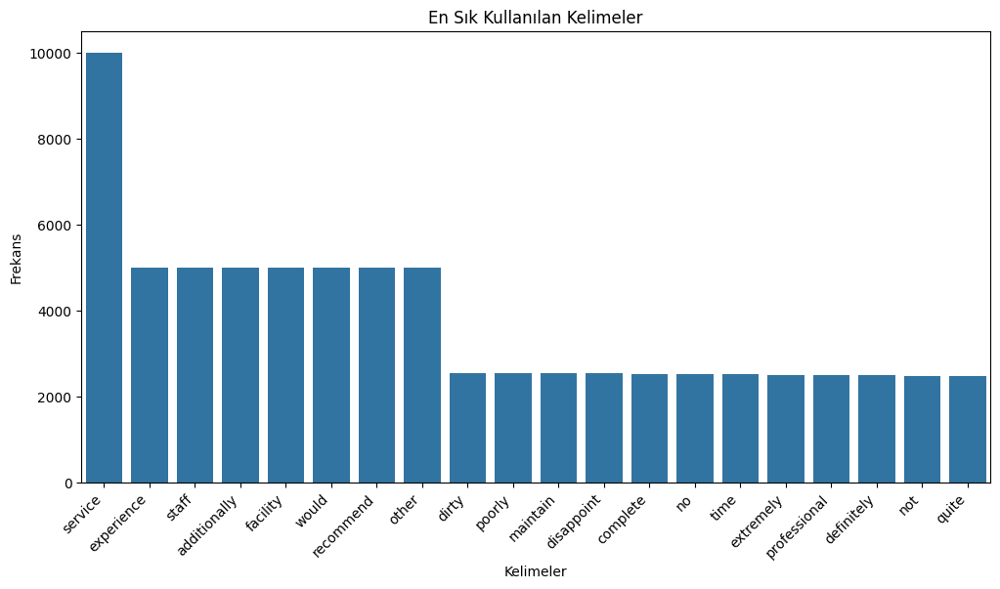

In [ ]:
all_words = " ".join(reviews_df['review_text_cleaned']).split()
word_freq = Counter(all_words)
top_words = word_freq.most_common(20)

words, freqs = zip(*top_words)

plt.figure(figsize=(12, 6))
sns.barplot(x=list(words), y=list(freqs))
plt.title('En Sık Kullanılan Kelimeler')
plt.xlabel('Kelimeler')
plt.ylabel('Frekans')
plt.xticks(rotation=45, ha='right')
plt.show()

In [ ]:
label_counts = reviews_df['position'].value_counts()
label_counts

,count
position,
positive_claim,1294
evidence,1246
negative_claim,1243
rebuttal,1217


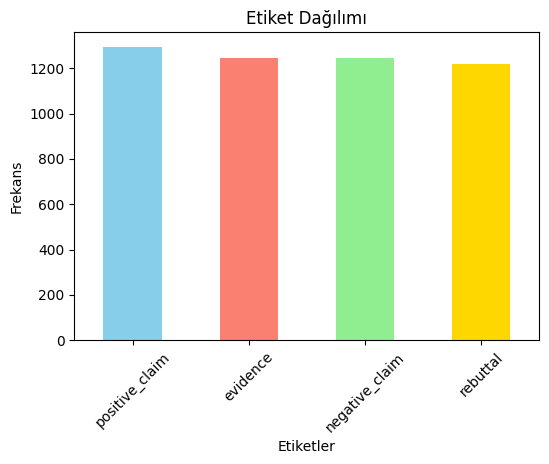

In [ ]:
plt.figure(figsize=(6, 4))
label_counts.plot(kind='bar', color=['skyblue', 'salmon', 'lightgreen', 'gold'])
plt.title("Etiket Dağılımı")
plt.xlabel("Etiketler")
plt.ylabel("Frekans")
plt.xticks(rotation=45)
plt.show()

In [ ]:
label_percentages = reviews_df['position'].value_counts(normalize=True) * 100
label_percentages

,proportion
position,
positive_claim,25.88
evidence,24.92
negative_claim,24.86
rebuttal,24.34


Şimdi her sınıfın birkaç örneğini gözden geçirerek etiketlerin metinlerle uyumlu olup olmadığını kontrol edelim. Etiketler çoğunlukla doğru görünüyor, ancak bu küçük örnekleme tüm veriyi temsil etmeyebilir. Bir sonraki adımda daha geniş bir tutarsızlık analizi yapmak için metinler arasındaki anahtar kelime dağılımlarını ve sınıflar arası ayırt ediciliği inceleyelim

- yorumlar önce eğitim ve test kümelerine ayrılmıştır. Ardından, TF-IDF vektörleri oluşturulmuş ve Lojistik Regresyon modeli eğitilmiştir. Bu sonuçlara göre modelin performansı düşük

In [ ]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Metin verilerini sayısal verilere dönüştür
tfidf = TfidfVectorizer()
X = tfidf.fit_transform(reviews_df['review_text_cleaned'])
y = reviews_df['position']

# Verileri eğitim ve test kümelerine ayır
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Modelleri tanımla
models = [
    ('Logistic Regression', LogisticRegression()),
    ('Naive Bayes', MultinomialNB()),
    ('SVM', SVC()),
    ('Decision Tree', DecisionTreeClassifier()),
    ('Random Forest', RandomForestClassifier())
]

# Modelleri eğit ve değerlendir
for name, model in models:
    # Çapraz doğrulama ile accuracy, precision, recall ve f1 skorlarını hesapla
    accuracy_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='accuracy')
    precision_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='precision_macro')
    recall_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='recall_macro')
    f1_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='f1_macro')

    # Sonuçları yazdır
    print(f'{name}:')
    print(f'  Accuracy: {accuracy_scores.mean()}')
    print(f'  Precision: {precision_scores.mean()}')
    print(f'  Recall: {recall_scores.mean()}')
    print(f'  F1-score: {f1_scores.mean()}')

Logistic Regression:
  Accuracy: 0.27
  Precision: 0.27166227661560505
  Recall: 0.2691904793418908
  F1-score: 0.26734081210008365
Naive Bayes:
  Accuracy: 0.26775000000000004
  Precision: 0.2691687898351791
  Recall: 0.26691349670941455
  F1-score: 0.26406114273732
SVM:
  Accuracy: 0.2585
  Precision: 0.25852730118631484
  Recall: 0.25773598294113287
  F1-score: 0.2565242248876899
Decision Tree:
  Accuracy: 0.257
  Precision: 0.2560924212177212
  Recall: 0.25660697830187884
  F1-score: 0.2534306970740536
Random Forest:
  Accuracy: 0.264
  Precision: 0.260622519512839
  Recall: 0.26523518467942653
  F1-score: 0.26425508888992016


In [ ]:
# from sklearn.model_selection import train_test_split
# from sklearn.linear_model import LogisticRegression
# from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# # Veriyi eğitim ve test kümelerine ayırın
# X_train, X_test, y_train, y_test = train_test_split(
#     reviews_df['review_text_cleaned'], reviews_df['position'], test_size=0.2, random_state=42
# )

# # TF-IDF vektörlerini oluşturun
# vectorizer = TfidfVectorizer()
# X_train = vectorizer.fit_transform(X_train)
# X_test = vectorizer.transform(X_test)

# # Lojistik Regresyon modelini eğitin
# model = LogisticRegression()
# model.fit(X_train, y_train)

# # Test verileri üzerinde tahmin yapın
# y_pred = model.predict(X_test)

# # Model performansını değerlendirin
# print(f"Accuracy: {accuracy_score(y_test, y_pred)}")
# print(f"Precision: {precision_score(y_test, y_pred, average='weighted')}")
# print(f"Recall: {recall_score(y_test, y_pred, average='weighted')}")
# print(f"F1-score: {f1_score(y_test, y_pred, average='weighted')}")

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer()

vectorizer.fit(reviews_df['review_text_cleaned'])

tfidf_matrix = vectorizer.transform(reviews_df['review_text_cleaned'])

print(tfidf_matrix[:5])

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 98 stored elements and shape (5, 46)>
  Coords	Values
  (0, 0)	0.13064778086180526
  (0, 1)	0.4330787963980471
  (0, 4)	0.4330787963980471
  (0, 11)	0.2187473884972851
  (0, 12)	0.21910680490239928
  (0, 13)	0.13064778086180526
  (0, 14)	0.22029475495701753
  (0, 15)	0.13064778086180526
  (0, 21)	0.2187473884972851
  (0, 25)	0.2219657325663871
  (0, 26)	0.13064778086180526
  (0, 28)	0.2187473884972851
  (0, 29)	0.22029475495701753
  (0, 31)	0.13064778086180526
  (0, 33)	0.2612955617236105
  (0, 35)	0.22275642156963546
  (0, 36)	0.13064778086180526
  (0, 42)	0.22275642156963546
  (0, 44)	0.13064778086180526
  (1, 0)	0.1280060182239779
  (1, 7)	0.21518111336724252
  (1, 11)	0.21432420829290263
  (1, 13)	0.1280060182239779
  (1, 15)	0.1280060182239779
  (1, 16)	0.2187712610583468
  :	:
  (3, 33)	0.25643337116996007
  (3, 34)	0.42093312802139393
  (3, 36)	0.12821668558498003
  (3, 39)	0.21553525013299413
  (3, 44)	0.128216685584

In [ ]:
from sklearn.decomposition import NMF

# Create an NMF model with 4 components
num_topics = 4
nmf_model = NMF(n_components=num_topics, random_state=42)

# Fit the model to the TF-IDF matrix
nmf_model.fit(tfidf_matrix)

# Show the components of the NMF model
for i, topic in enumerate(nmf_model.components_):
   print(f"Topic {i}: {topic}")

Topic 0: [1.27517657 0.47528352 0.33851543 0.303913   0.47528352 0.
 0.         0.20526333 0.36988162 1.07947361 0.         3.35858038
 0.95398006 1.27517657 1.26338071 1.27517657 1.20718917 0.38479372
 0.303913   0.36988162 0.53206415 3.35858038 0.36988162 0.49252573
 0.20526333 1.07932837 1.27517657 0.42910723 3.35858038 1.26338071
 0.88918789 1.27517657 0.49252573 2.55035314 0.38479372 1.5175554
 1.27517657 0.33851543 0.42910723 0.20526333 0.88918789 0.57398636
 1.5175554  0.         1.27517657 0.53206415]
Topic 1: [0.71851157 0.2145814  0.23148897 0.32958898 0.2145814  0.79193686
 0.         2.03249788 0.25897103 0.59262074 0.         0.18486569
 0.67289062 0.71851157 0.60637387 0.71851157 0.5422608  0.20118238
 0.32958898 0.25897103 0.1886488  0.18486569 0.25897103 0.24376241
 2.03249788 0.62388988 0.71851157 0.25359566 0.18486569 0.60637387
 0.60810473 0.71851157 0.24376241 1.43702315 0.20118238 0.
 0.71851157 0.23148897 0.25359566 2.03249788 0.60810473 0.31676778
 0.         0.7

/usr/local/lib/python3.10/dist-packages/sklearn/decomposition/_nmf.py:1759: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


In [ ]:
# Predict the topic for each review
predicted_topics = nmf_model.transform(tfidf_matrix)

# Show the first 5 rows of the predicted topics
predicted_topics[:5]

array([[0.07385692, 0.        , 0.04093088, 0.        ],
       [0.04996975, 0.08965259, 0.        , 0.00366173],
       [0.        , 0.10367377, 0.02398686, 0.17661645],
       [0.05179297, 0.08973326, 0.        , 0.        ],
       [0.04830238, 0.09650368, 0.        , 0.        ]])

In [ ]:
# Get the dominant topic for each review
dominant_topics = predicted_topics.argmax(axis=1)

# Show the first 5 rows of the dominant topics
dominant_topics[:5]

array([0, 1, 3, 1, 1])

In [ ]:
# Get the feature names (words) from the vectorizer
feature_names = vectorizer.get_feature_names_out()

# For each topic, print the top 10 words with the highest weights
for i, topic in enumerate(nmf_model.components_):
    top_words_indices = topic.argsort()[-10:]
    top_words = [feature_names[j] for j in top_words_indices]
    print(f"Topic {i}: {', '.join(top_words)}")

Topic 0: would, facility, recommend, other, very, slow, service, dirty, poorly, maintain
Topic 1: facility, would, recommend, additionally, clean, wellmaintaine, service, complete, time, no
Topic 2: other, would, experience, facility, additionally, very, slow, clean, wellmaintaine, service
Topic 3: recommend, experience, other, would, definitely, unprofessional, quite, service, cleaning, dental


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(ngram_range=(1, 2))
tfidf_matrix = vectorizer.fit_transform(reviews_df['review_text_cleaned'])

tfidf_matrix.shape

(5000, 97)

In [ ]:
feature_names = vectorizer.get_feature_names_out()
feature_names

array(['additionally', 'additionally facility', 'adjustment',
       'adjustment experience', 'blood', 'blood test', 'checkup',
       'checkup experience', 'chiropractic', 'chiropractic adjustment',
       'clean', 'clean wellmaintaine', 'cleaning', 'cleaning experience',
       'complete', 'complete no', 'counseling', 'counseling experience',
       'definitely', 'definitely recommend', 'dental', 'dental cleaning',
       'dirty', 'dirty poorly', 'disappoint', 'disappoint staff',
       'experience', 'experience disappoint', 'experience fantastic',
       'extremely', 'extremely professional', 'facility',
       'facility clean', 'facility dirty', 'fantastic', 'fantastic staff',
       'flu', 'flu shot', 'general', 'general checkup', 'health',
       'health counseling', 'imaging', 'imaging experience', 'maintain',
       'maintain would', 'mental', 'mental health', 'mri', 'mri scan',
       'no', 'no time', 'not', 'not recommend', 'other', 'physical',
       'physical therapy', 'poo

In [ ]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer


text_column = "review_text_cleaned"
text_data = reviews_df[text_column].dropna()

tfidf_vectorizer = TfidfVectorizer(max_features=1000, stop_words='english')
tfidf_matrix = tfidf_vectorizer.fit_transform(text_data)

count_vectorizer = CountVectorizer(max_features=1000, stop_words='english')
count_matrix = count_vectorizer.fit_transform(text_data)

tfidf_matrix_df = pd.DataFrame(tfidf_matrix.toarray(), columns=tfidf_vectorizer.get_feature_names_out())
count_matrix_df = pd.DataFrame(count_matrix.toarray(), columns=count_vectorizer.get_feature_names_out())

tfidf_matrix_df.head()

,additionally,adjustment,blood,checkup,chiropractic,clean,cleaning,complete,counseling,definitely,...,shot,slow,staff,test,therapy,time,unprofessional,vaccination,wellmaintaine,xray
0,0.140313,0.465119,0.0,0.000000,0.465119,0.000000,0.000000,0.000000,0.0,0.00000,...,0.000000,0.239236,0.140313,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
1,0.136951,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.230219,0.0,0.00000,...,0.449609,0.000000,0.136951,0.0,0.0,0.230219,0.232786,0.0,0.000000,0.0
2,0.137003,0.000000,0.0,0.000000,0.000000,0.234539,0.447383,0.230306,0.0,0.23112,...,0.000000,0.000000,0.137003,0.0,0.0,0.230306,0.232874,0.0,0.234539,0.0
3,0.137210,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.230652,0.0,0.00000,...,0.450457,0.000000,0.137210,0.0,0.0,0.230652,0.000000,0.0,0.000000,0.0
4,0.135971,0.000000,0.0,0.456344,0.000000,0.000000,0.000000,0.228571,0.0,0.00000,...,0.000000,0.000000,0.135971,0.0,0.0,0.228571,0.000000,0.0,0.000000,0.0


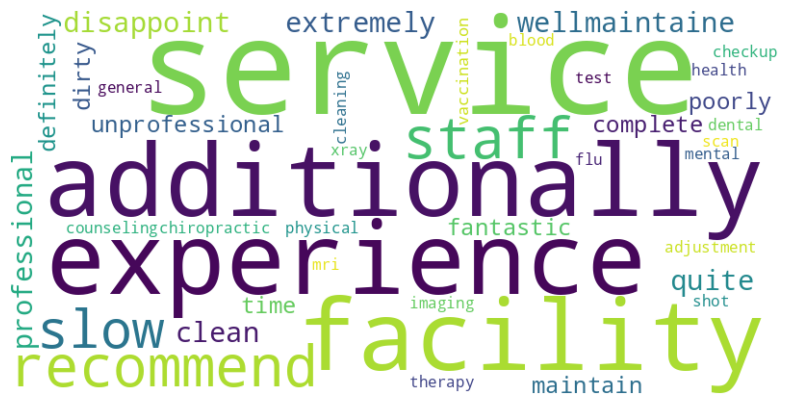

In [ ]:
from wordcloud import WordCloud

# TF-IDF değerlerini sözlük yapısına dönüştür
tfidf_dict = tfidf_matrix_df.T.sum(axis=1).to_dict()

# Kelime bulutu oluştur
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(tfidf_dict)

# Kelime bulutunu göster
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

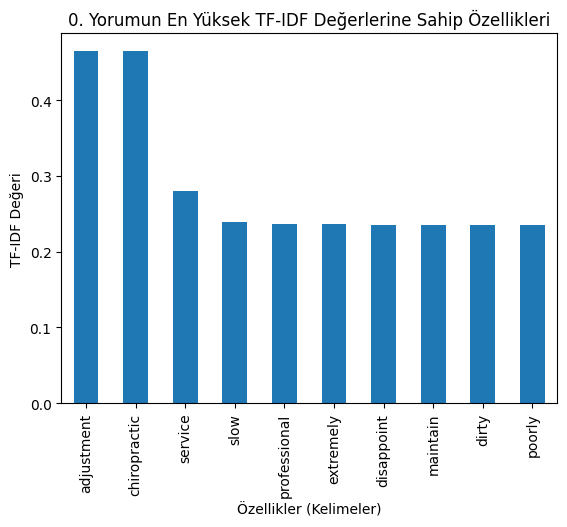

In [ ]:
# Belirli bir yorumun (örneğin, 0. indeksli yorum) özellik değerlerini gösteren çubuk grafik
tfidf_matrix_df.iloc[0].sort_values(ascending=False).head(10).plot(kind='bar')
plt.title("0. Yorumun En Yüksek TF-IDF Değerlerine Sahip Özellikleri")
plt.xlabel("Özellikler (Kelimeler)")
plt.ylabel("TF-IDF Değeri")
plt.show()

In [ ]:
count_matrix_df.head()

,additionally,adjustment,blood,checkup,chiropractic,clean,cleaning,complete,counseling,definitely,...,shot,slow,staff,test,therapy,time,unprofessional,vaccination,wellmaintaine,xray
0,1,1,0,0,1,0,0,0,0,0,...,0,1,1,0,0,0,0,0,0,0
1,1,0,0,0,0,0,0,1,0,0,...,1,0,1,0,0,1,1,0,0,0
2,1,0,0,0,0,1,1,1,0,1,...,0,0,1,0,0,1,1,0,1,0
3,1,0,0,0,0,0,0,1,0,0,...,1,0,1,0,0,1,0,0,0,0
4,1,0,0,1,0,0,0,1,0,0,...,0,0,1,0,0,1,0,0,0,0


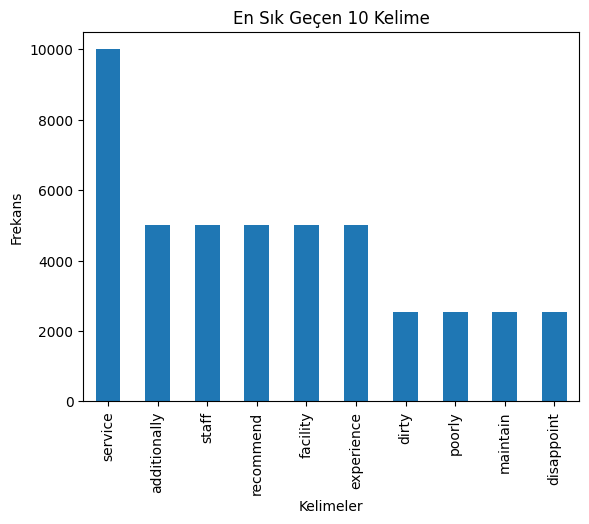

In [ ]:
count_matrix_df.sum().sort_values(ascending=False).head(10).plot(kind='bar')
plt.title("En Sık Geçen 10 Kelime")
plt.xlabel("Kelimeler")
plt.ylabel("Frekans")
plt.show()

TF-IDF ile Tekrar ve Benzerlik Kontrolü
Eğer metinler çok fazla uzun ve kompleksse, TF-IDF (Term Frequency-Inverse Document Frequency) tabanlı bir yaklaşımla metinlerin benzerliğini kontrol edebilirsiniz.

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

# TF-IDF matrisi oluştur
tfidf = TfidfVectorizer()
tfidf_matrix = tfidf.fit_transform(reviews_df['review_text_cleaned'])

# Cosine benzerliği hesapla
cosine_sim = cosine_similarity(tfidf_matrix)

# Belirli bir eşik üzerinde benzer metinleri seç
threshold = 0.85
similar_pairs = []

for i in range(len(cosine_sim)):
    for j in range(i + 1, len(cosine_sim)):
        if cosine_sim[i, j] > threshold:
            similar_pairs.append((i, j, cosine_sim[i, j]))

print(f"Benzer metin çiftleri (eşik: {threshold}):")
print(similar_pairs)

Benzer metin çiftleri (eşik: 0.85):
[(0, 9, 0.8779395894158608), (0, 15, 0.8819673270716606), (0, 36, 0.9084690806927954), (0, 38, 0.8779613269466519), (0, 61, 1.0000000000000002), (0, 65, 0.8523466982288522), (0, 73, 0.9389420649685916), (0, 101, 0.8819673270716606), (0, 117, 1.0000000000000002), (0, 118, 0.9083394139642429), (0, 130, 0.9084062966415049), (0, 141, 0.9084062966415049), (0, 149, 0.9694497669058589), (0, 170, 0.8778505662487237), (0, 171, 0.8779613269466519), (0, 198, 0.9083394139642429), (0, 206, 0.8779395894158608), (0, 230, 0.8820714303563564), (0, 268, 0.8779395894158608), (0, 296, 0.9389060626834104), (0, 306, 0.8778505662487237), (0, 401, 0.9084690806927954), (0, 450, 0.9389420649685916), (0, 456, 0.9084062966415049), (0, 482, 0.8523466982288522), (0, 500, 0.938892357123199), (0, 538, 0.8779613269466519), (0, 552, 0.9084690806927954), (0, 562, 0.8779395894158608), (0, 567, 0.8819673270716606), (0, 608, 0.9389060626834104), (0, 619, 0.8778505662487237), (0, 625, 0.8

# **Cümle** Benzerliği (Semantic Similarity)

In [ ]:
label_mapping = {
    'positive_claim': 'claim',
    'negative_claim': 'counterclaim',
    'evidence': 'evidence',
    'rebuttal': 'rebuttal'
}

reviews_df['new_position'] = reviews_df['position'].map(label_mapping)

In [ ]:
from sentence_transformers import SentenceTransformer, util

model = SentenceTransformer('all-MiniLM-L6-v2')

reference_texts = {
    'claim': "This is a statement expressing an opinion or belief.",
    'evidence': "This is supporting evidence for a claim.",
    'counterclaim': "This is a statement opposing a claim.",
    'rebuttal': "This is a counterargument to a counterclaim."
}

reference_embeddings = {key: model.encode(value) for key, value in reference_texts.items()}

# Yorumların embedding'lerini hesapla
review_embeddings = model.encode(reviews_df['review_text_cleaned'].tolist())

# Her yorum için en yakın referans sınıfını bul
def classify_text(embedding):
    scores = {label: util.cos_sim(embedding, ref_emb).item() for label, ref_emb in reference_embeddings.items()}
    return max(scores, key=scores.get)

# Yeni etiketleri ata
reviews_df['classified_position'] = [classify_text(emb) for emb in review_embeddings]

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [ ]:
reviews_df[['review_text_cleaned', 'classified_position']].head(20)

,review_text_cleaned,classified_position
0,chiropractic adjustment experience disappoint ...,evidence
1,flu shot experience fantastic staff quite unpr...,counterclaim
2,dental cleaning experience disappoint staff qu...,rebuttal
3,flu shot experience disappoint staff extremely...,counterclaim
4,general checkup experience disappoint staff ex...,evidence
5,blood test experience fantastic staff quite un...,evidence
6,mri scan experience disappoint staff extremely...,evidence
7,mri scan experience disappoint staff quite unp...,counterclaim
8,flu shot experience fantastic staff quite unpr...,rebuttal
9,chiropractic adjustment experience fantastic s...,evidence


In [ ]:
reviews_df['classified_position'].value_counts()

,count
classified_position,
evidence,2786
counterclaim,1520
rebuttal,575
claim,119


In [ ]:
from sklearn.metrics import confusion_matrix

# Karışıklık matrisini oluştur
cm = confusion_matrix(reviews_df['position'], reviews_df['classified_position'])

# Karışıklık matrisini yazdır
print(cm)

[[  0   0   0   0   0   0]
 [  0   0   0   0   0   0]
 [ 16 373 702   0   0 155]
 [ 32 359 704   0   0 148]
 [ 34 397 712   0   0 151]
 [ 37 391 668   0   0 121]]


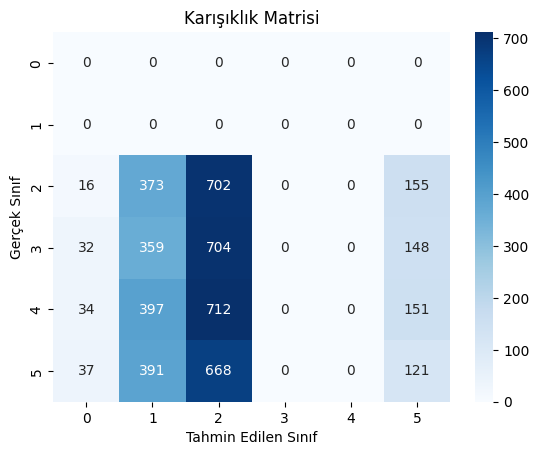

In [ ]:
import seaborn as sns

sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.title("Karışıklık Matrisi")
plt.xlabel("Tahmin Edilen Sınıf")
plt.ylabel("Gerçek Sınıf")
plt.show()

In [ ]:
# Eski ve yeni etiketler arasında uyuşmazlıkları bulun
mislabeled = reviews_df[reviews_df['new_position'] != reviews_df['classified_position']]

# Yanlış sınıflandırılmış örnekleri inceleyin
mislabeled[['review_text_cleaned', 'new_position', 'classified_position']].head(20)

                                  review_text_cleaned  new_position  \
0   chiropractic adjustment experience disappoint ...  counterclaim   
3   flu shot experience disappoint staff extremely...      evidence   
5   blood test experience fantastic staff quite un...  counterclaim   
8   flu shot experience fantastic staff quite unpr...      evidence   
10  mri scan experience disappoint staff extremely...      rebuttal   
12  blood test experience disappoint staff quite u...  counterclaim   
13  vaccination experience disappoint staff extrem...      rebuttal   
14  flu shot experience fantastic staff extremely ...      rebuttal   
15  chiropractic adjustment experience disappoint ...         claim   
16  dental cleaning experience disappoint staff qu...         claim   
19  physical therapy experience fantastic staff ex...      rebuttal   
20  mental health counseling experience disappoint...  counterclaim   
21  xray imaging experience fantastic staff quite ...      rebuttal   
22  ch

In [ ]:
from sentence_transformers import SentenceTransformer, util

model = SentenceTransformer('paraphrase-MiniLM-L6-v2')

# Örnek etiket metinleri
label_texts = {
    'claim': "The main point of the service",
    'evidence': "Supporting evidence for the service",
    'counterclaim': "A negative view about the service",
    'rebuttal': "A response to a counterclaim"
}

# Benzerlik hesaplama
for index, row in reviews_df.iterrows():
    review_embedding = model.encode(row['review_text_cleaned'], convert_to_tensor=True)
    label_embedding = model.encode(label_texts[row['position']], convert_to_tensor=True)
    similarity_score = util.cos_sim(review_embedding, label_embedding)

    if similarity_score < 0.5:  # Düşük benzerlik eşiği
        print(f"Potential Mislabeling: {row['review_text_cleaned']}")
        print(f"Assigned Label: {row['position']}, Similarity Score: {similarity_score}")
